# 2,5-diiodobenzonitrile 30 keV

Static Scattering + Rotations with SO3 sampling + Alignment (ADMs), testing with N2 ADMs

06/02/25

Updated plots for HTML output (sliders not working currently).

22/01/25

Testing with N2 and other molecules.

- 2,5-diiodo-benzonitrile (DIBN) as per Kupper et. al. (2013). Lots of structure in this case.
- naphthalene per Pabst et. al. (2010). Some structure here, but don't fully resolve - need to change some scattering energies/parameters to match examples in manuscript, or limitation of simple scattering model?


17/01/25

As 15/01/25 case, but test with N2O plus test ADMs (use N2 case).

15/01/25, PH

Adding full treatment of alignment from ADMs (inc. coherence).

- For previous work, see http://fock.femtolab.ca:9988/lab/tree/share/projects/sacla/no2_scattering_Oct_2024/modelling/scattering_rotations_sampling_091224.ipynb
- For alignment dev and tests, see http://fock.femtolab.ca:9988/lab/tree/share/code-share/jupyter-shared/numerical_integration_sampling_2024/rotations_SO3/coherent_rotations_150125.ipynb

09/12/24, PH

Adapted from Ian Gabalski's scatting codes, adding:

- molecule rotations
    - In this version use SciPy for rotations instead of RDkit
- sampling over rotational distributions
    - Use OpenQuad library, quickStart: https://qucontrol.github.io/openquad/latest/using/quickstart.html#quickstart

Functions quick and dirty in `scattering_funcs.py`, just load here then work from there.

For initial demo see http://fock.femtolab.ca:9988/lab/tree/share/projects/sacla/no2_scattering_Oct_2024/modelling/scattering_rotations_061224.ipynb

For dev notes see http://fock.femtolab.ca:9988/lab/tree/share/projects/sacla/no2_scattering_Oct_2024/modelling/Static%20Scattering%20-%20with%20anisotropy%20-%20PH_031224.ipynb

STATUS: basically seems to be working as expected!

---

Refs:

Jochen Kupper et al. “X-Ray Diffraction from Isolated and Strongly Aligned Gas-Phase Molecules
with a Free-Electron Laser”. In: Physical Review Letters 112.8 (Feb. 28, 2014), p. 083002. issn:
0031-9007. doi: 10.1103/PhysRevLett.112.083002. url: http://arxiv.org/abs/1307.4577

Stefan Pabst, Phay J. Ho, and Robin Santra. “Computational Studies of X-Ray Scattering from
Three-Dimensionally-Aligned Asymmetric-Top Molecules”. In: Physical Review A 81.4 (Apr. 29,
2010), p. 043425. doi: 10.1103/PhysRevA.81.043425. url: https://link.aps.org/doi/10.
1103/PhysRevA.81.043425

In [1]:
# Set photon energy keV
photon_energy = 30e3

In [2]:
%run scattering_funcs.py --photonE $photon_energy

*** Setting some constants and loading form factor data form file.
Running for photon energy = 30000.000 eV, \lambda = 0.413 nm.
*** Loading HV plotters...


*** Loading epsman and related modules for molecule handling.
If this fails, you may need epsman, `pip install -e epsman --user` (and `git clone -b restructure160221 https://github.com/phockett/epsman.git` to get the source), and maybe also `pip install fabric pygamess rdkit --user` for dependencies.
*** py3Dmol not available, 3D plots with RDkit will not be available.


In [3]:
# May need this for MPL backend
%matplotlib inline

## Import molecule with epsman/rdkit routines

Note for multiple rotations case can also just work directly from Numpy (x,y,z) coord array, but use rdkit here for plotters etc.

In [4]:
# Note this is currently set in the script.
# xyzPath

Set name = 2,5-diiodobenzonitrile
Set smiles = None
Set molFile = None
Set pd = None
Set xyz = None
Set molOverride = None
*** File /home/jovyan/share/projects/sacla/no2_scattering_Oct_2024/modelling/2,5-diiodobenzonitrile.SDF already exists; existing file will be used. Pass overwrite=True to overwrite.
Set job = None
Set sym = C1
Set atomList = None
Set precision = 6
Set atomsDict = {}
Set refDict = {}
Set atomsHist = {}
*** Updating coords (Pandas version).


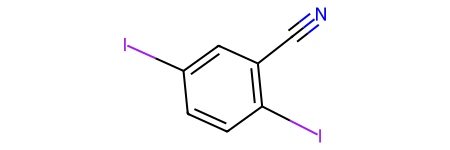

,Ind,Species,Atomic Num.,x,y,z
0,0,I,53,2.6016,-1.9281,0.0003
1,1,I,53,-3.7067,1.0264,0.0001
2,2,N,7,2.6316,2.0103,0.0000
3,3,C,6,0.5918,0.4130,-0.0001
4,4,C,6,0.7302,-0.9750,-0.0001
5,5,C,6,-0.6795,0.9871,0.0000
6,6,C,6,-1.8123,0.1733,0.0001
7,7,C,6,-0.4026,-1.7888,-0.0002
8,8,C,6,-1.6738,-1.2147,-0.0001
9,9,C,6,1.7198,1.2963,0.0000


In [5]:
# molecule='SF6'

# SF6 = loadMol(molecule, xyzPath)

#**** Use downloader...  NOPE, it's rubbish.
# molecule = 'naphthalene'
molecule = '2,5-diiodobenzonitrile'
# molecule = 'nitric oxide'
# molecule = 'Nitrogen Dioxide'
mol = ESgamess(searchName = molecule)
# mol.molFromPubChem(recordType='2d')  # ANNOYING - for NO2 2D only, and only full name works? Pubchem page: https://pubchem.ncbi.nlm.nih.gov/compound/Nitrogen-dioxide
#                                      # ALSO THIS MESSES UP SOME OTHER CLASS CREATION STUFF. FIX THIS PLEASE

#*** Use file (downloaded above
# molecule = 'NO2'
# mol = ESgamess(molFile = f'{molecule}.SDF')

In [6]:
# Set orientation to z-axis if desired (or set other arb rotation)
# mol.rotateFrame()
# mol.plot2D()

## Sampling over SO3

In [7]:
from openquad import SO3

def sampleSO3(degree=3,size=3):
    """
    Sample over SO3 using OpenQuad
    
    Use recommended method in Quickstart, with passing of degree and size.
    
    """
    
    quad = SO3([
        ('LebedevLaikov', dict(degree=degree)),
        ('Trapezoid', dict(size=size)),
        ])
    
    print(f"Generated samples on SO3: {quad.points.shape}.")
          
    return quad

In [8]:
quadSample = sampleSO3()

Generated samples on SO3: (3, 18).


## Rotations with SciPy

In [9]:
from scipy.spatial.transform import Rotation as R

def rotateXYZ(xyz, eulerAngles=[0,0,0]):
    """
    Rotate coord array.
    
    Uses scipy.spatial.transform.Rotation
    
    Pass np.array of [x,y,z] coords and set of Euler angles (radians). 
    
    
    """
    
    r = R.from_euler("ZYX", eulerAngles)  # intrinsic - THIS CASE MATCHES RDKIT METHOD
    # r2 = R.from_euler("zyx", [0, np.pi/2, np.pi/3])  # extrinsic
    
    xyzR = r.apply(xyz)
    
    return xyzR


def genMolRotations(mol, samples):
    """
    Generate all molecular rotations for sample array.
    
    mol can be [species,x,y,z] coord array, or ESgamess class object.
    
    Returns dictionary of rotated coords and corresponding Euler angles.
    """
    
    # Check input type, allow for class not loaded case
    xyzMol = mol
    try:
        if isinstance(mol, ESgamess):
            if not 'ref' in mol.refDict.keys():
                mol.setRef()
                
            xyzMol = mol.refDict['ref']['pd'][['Species','x','y','z']].to_numpy()
    except:
        pass
    
    # Generate rotations
    geoms = {}
    for n,eulers in enumerate(samples.angles.T):
        geoms[n] = {'xyz':np.c_[xyzMol[:,0],rotateXYZ(xyzMol[:,1:].astype(float),eulers)],
                   'eulers':eulers,
                   'w':samples.weights[n]}
        
    # geom['ref'] = 
        
    return geoms
    
    # return rotateXYZ(xyz,samples.angles)

In [10]:
geomsDict = genMolRotations(mol,quadSample)

,Ind,Species,Atomic Num.,x,y,z
0,0,I,53,2.6016,-1.9281,0.0003
1,1,I,53,-3.7067,1.0264,0.0001
2,2,N,7,2.6316,2.0103,0.0000
3,3,C,6,0.5918,0.4130,-0.0001
4,4,C,6,0.7302,-0.9750,-0.0001
5,5,C,6,-0.6795,0.9871,0.0000
6,6,C,6,-1.8123,0.1733,0.0001
7,7,C,6,-0.4026,-1.7888,-0.0002
8,8,C,6,-1.6738,-1.2147,-0.0001
9,9,C,6,1.7198,1.2963,0.0000


Set reference coords key 'ref' from self.atomsDict.


## Compute scattering with spatial sampling

In [11]:
def multScatter(geomsDict, QQ):
    """
    Compute scattering for each [x,y,z] in geomDict.
    """
    
    scatSum = np.zeros(QQ.shape[0:-1]).astype(complex)
    
    scatDict = {}
    for k,v in geomsDict.items():
        
        fQ = scatteringPairs(v['xyz'],QQ)
        
        scatDict[k] = {'f':fQ,
                       'w':v['w']}
        
        scatSum += v['w'] * fQ
        
    # Push to Xarray?
    
    # Direct summation
    
    return scatSum, scatDict
    
    
        
    

In [12]:
scatSum, scatDict = multScatter(geomsDict,QQ)

/home/jovyan/share/projects/sacla/no2_scattering_Oct_2024/modelling/scattering_funcs.py:271: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  plt.pcolormesh(QQx,QQy,ffplot, norm=norm)


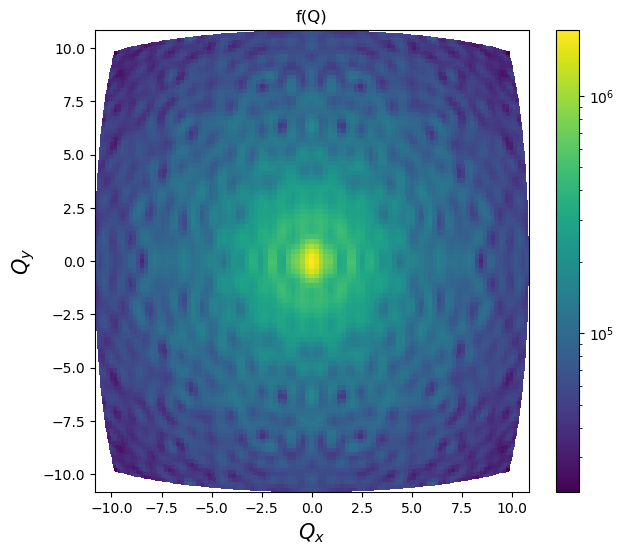

In [13]:
plotter = 'mpl'
plotff2(QQ,scatSum, backend=plotter, norm='log')

### Scattering with alignment - basic case

Add angular weightings to simulate aligned case, here just set $\cos^2(\theta)$ weighting.

Generated samples on SO3: (3, 962).


/home/jovyan/share/projects/sacla/no2_scattering_Oct_2024/modelling/scattering_funcs.py:271: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  plt.pcolormesh(QQx,QQy,ffplot, norm=norm)


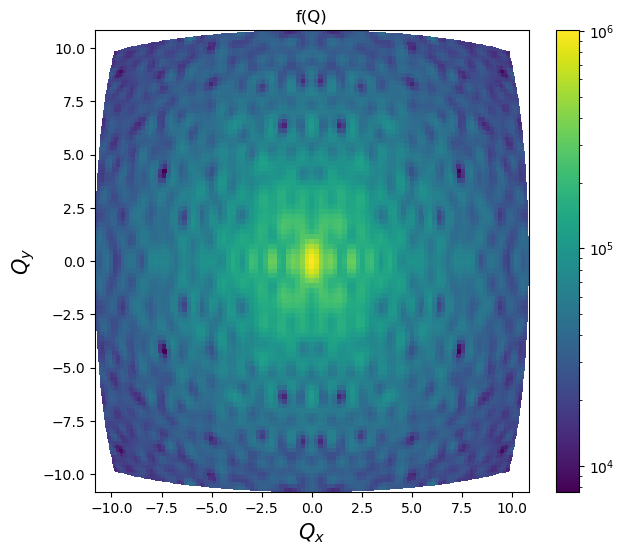

In [14]:
# Quick test for cos^2 dist...

# Update sampling if desired
n=13
quadSampleAlign = sampleSO3(degree=n,size=n)
geomsDictAlign = genMolRotations(mol,quadSample)
scatSumAlign, scatDictAlign = multScatter(geomsDictAlign,QQ)

# Set to new dict
alignDict = scatDictAlign.copy()
scatSumAligned = np.zeros(QQ.shape[0:-1]).astype(complex)

for k,v in alignDict.items():
    theta = geomsDict[k]['eulers'][0]
    scatSumAligned += v['w'] * v['f'] * 0.8*np.cos(theta)**2   # Add higher order terms... * 0.3*np.cos(theta)**4
    
plotff2(QQ,scatSumAligned, backend=plotter, norm='log')

In [15]:
def diffPlot(S1, S2, norm = True, plot = True):
    """
    Compute diffs and plot.
    
    Normalise if norm=True
    """
    if norm:
        S1 = S1/S1.sum()
        S2 = S2/S2.sum()
    
    diff = S1-S2
    
    if plot:
        plotff2(QQ,diff, backend=plotter)
    
    return diff

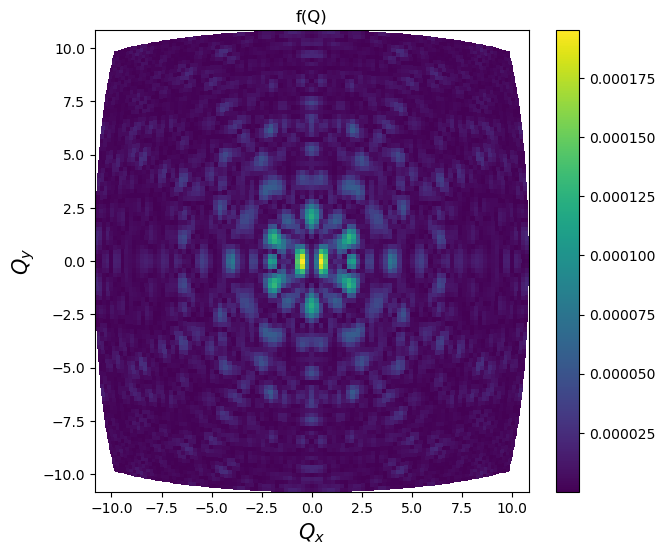

In [16]:
# Diff...
diff = diffPlot(scatSumAligned, scatSum, norm=True)

### Scattering with alignment - rotational wavepacket and ADMs case

TODO: confirm consistent axis defns. relative to input molecule and scattering plane.

Following Pabst et. al., who give (as expected) the result for the scattering x-section $S(Q)$ from an aligned ensemble as:

\begin{equation}
\begin{split}
S \left(\right. Q \left.\right) & =  \int_{- \infty}^{\infty} dt \textrm{ } j_{X} \left(\right. t \left.\right) \iiint d \phi \textrm{ } d \theta \textrm{ } d \chi sin \theta \\ & \times  \rho \left(\right. \phi , \theta , \chi ; t \left.\right) \left|\right. F_{mol} \left(\right. Q , \phi , \theta , \chi \left.\right) \left|\right. ^{2}
\end{split}\label{eqn33}
\end{equation}

Where the density matrix is determined from the rotational wavepacket:

\begin{equation}
\rho \left(\right. \phi , \theta , \chi ; t \left.\right)  =  \sum_{J \tau M} w_{J \tau} \left|\right. \langle \phi , \theta , \chi \left|\right. \Psi_{J \tau M} \left(\right. t \left.\right) \rangle \left|\right. ^{2}
\label{eqn35}
\end{equation}

We can also (as usual) express this density matrix as the (spatial) axis distribution moments (ADMs), with Wigner D functions as the angular basis:

\begin{equation}
\rho \left(\right. \phi , \theta , \chi ; t \left.\right)  = \sum_{K,Q,S}A^{K}_{Q,S}(t)D^{K}_{Q,S}(\phi , \theta , \chi)
\end{equation}

In this case this would be something like (to be verified - need to check some aspect of $\rho \left(\right. \phi , \theta , \chi ; t \left.\right)$ derivation), following the notation as above:

\begin{equation}
\begin{split}
S \left(\right. Q \left.\right) & =  \int_{- \infty}^{\infty} dt \textrm{ } j_{X} ( t ) 
\iiint d \phi  d \theta \textrm{ } d \chi sin \theta \\ & \times  \sum_{K,Q,S}A^{K}_{Q,S}(t)D^{K}_{Q,S}(\phi , \theta , \chi)  F_{mol} ( Q , \phi , \theta , \chi ) F_{mol}^{*} ( Q , \phi , \theta , \chi ) 
\end{split}\label{eqn33-coherent-ADM}
\end{equation}

In the numerics below this is implemented aside from the pulse $j_{X}(t)$ and temporal integration (i.e. equivalent to an impulsive assumption on the rotational timescale).

Ref: Stefan Pabst, Phay J. Ho, and Robin Santra. “Computational Studies of X-Ray Scattering from
Three-Dimensionally-Aligned Asymmetric-Top Molecules”. In: Physical Review A 81.4 (Apr. 29,
2010), p. 043425. doi: 10.1103/PhysRevA.81.043425. url: https://link.aps.org/doi/10.
1103/PhysRevA.81.043425 

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


* natsort not found, some sorting functions not available. 
* Setting plotter defaults with epsproc.basicPlotters.setPlotters(). Run directly to modify, or change options in local env.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
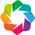

* Set Holoviews with bokeh.
* pyevtk not found, VTK export not available. 


:NdOverlay   [S,Q,K]
   :Curve   [t]   (ADM)

In [17]:
# Load N2 case
# Code from QM3 book
# TODO: redo with ep.ADM class, currently in progress/dev elsewhere.

from pathlib import Path
from scipy.io import loadmat
import epsproc as ep

admFileName = 'N2_ADM_VM_290816.mat'
# epDemoDataPath = Path(ep.__path__[0]).parent/'data'
epDemoDataPath = '/home/jovyan/share/code-share/github-share/ePSproc/data'
ADMdataFile = Path(epDemoDataPath, 'alignment', admFileName)

ADMraw = loadmat(ADMdataFile)
tOffset = -3.76
ADMraw['time'] = ADMraw['time'] + tOffset

ADMxr = ep.setADMs(ADMs = ADMraw['ADM'], t=ADMraw['time'].squeeze(), 
                  KQSLabels = ADMraw['ADMlist'], addS = True)

# Quick plot
ADMxr.unstack().real.hvplot(x='t').overlay(['K','Q','S'])

In [18]:
# Case using ADMs and Wigner D expansions
# From http://fock.femtolab.ca:9988/lab/tree/share/code-share/jupyter-shared/numerical_integration_sampling_2024/rotations_SO3/coherent_rotations_150125.ipynb

# import epsproc as ep
import xarray as xr

# Set alignment terms (ADMs), expressed as [K,Q,S,t0,t1...]
# ADMs = ep.setADMs(ADMs = [[0,0,0,1,1,1,1],
#                           [2,0,0,0,0.5,0.8,0.8],
#                           [4,0,0,0,0,0,0.8]])

# ADMs from full calc with subselection by range & step size.
trange = [2,10]  # [2,6]
ADMs = ADMxr.where(ADMxr.t>trange[0]).where(ADMxr.t<trange[1]).dropna('t').isel(t=slice(None,None,20))

# Generate Wigner D functions as required - all Eulers and K,Q,S
wD = ep.wDcalc(Lrange=ADMs.ADM.K.values, eAngs=quadSample.angles.T, dlist=['K', 'Q', 'S'])

# Expansion p(Omega,t)... 
# Currently need to unstack for non-matching multi-index names?
# Should check code elsewhere for other options here.
pt = ADMs.unstack('ADM') * wD.unstack('QN')

# For full sampling sum over K,Q,S and multiply by quadSample.weights
# ptWeights = pt.sum(['K','Q','S']) * quadSample.weights 
# Weights now in loop below, so only set sum
ptSum = pt.sum(['K','Q','S'])

# Compute scattering
# As above, but add loop over t for quick hacky mod!
# Note this assumes t is first dim of array, and index == keys in alignDict (value per set of Eulers)
scatSumt = np.zeros([*QQ.shape[0:-1],ptSum.shape[0]]).astype(complex)
for n,tWeight in enumerate(ptSum):
    alignDict = scatDict.copy()
    scatSumAligned = np.zeros(QQ.shape[0:-1]).astype(complex)

    for k,v in alignDict.items():
        theta = geomsDict[k]['eulers'][0]
        scatSumAligned += v['w'] * v['f'] * tWeight.values[k]

    # plotff2(QQ,scatSumAligned, backend=plotter, norm='log')
    
    scatSumt[:,:,n] = scatSumAligned.copy()
    
# Set final results to XR
# NOTE - probably a neater way to do this!
# TODO - push to existing VMI plotter

# scatXR = xr.DataArray(scatSumt, {'Qx':QQ[0,:],'Qy':QQ[:,0],'t':tWeight.t)
scatXR = xr.DataArray(scatSumt, dims=('Qx','Qy','t'), 
                      coords={'Qx':QQ[0,:,0].flatten(),'Qy':QQ[0,:,0].flatten(),'t':ptSum.t})  # NOTE: currently using Qx for both coord sets.
# scatXR

In [19]:
scatXR.t

<xarray.DataArray 't' (t: 21)>
array([2.010431, 2.404005, 2.797579, 3.191152, 3.584726, 3.978299, 4.371873,
       4.765447, 5.15902 , 5.552594, 5.946167, 6.339741, 6.733315, 7.126888,
       7.520462, 7.914035, 8.307609, 8.701183, 9.094756, 9.48833 , 9.881903])
Coordinates:
  * t        (t) float64 2.01 2.404 2.798 3.191 ... 8.701 9.095 9.488 9.882
Attributes:
    units:    ps

In [20]:
# HV plot from XR
# import hvplot.xarray

# Plot raw imgs vs. t
# scatXR.real.hvplot.image(x='Qx',y='Qy')

# Plot with log scaling
# scatXR.real.hvplot.image(x='Qx',y='Qy',logz=True)

# Testing quadmesh with layout for HTML export
scatXR.real.hvplot.quadmesh(x='Qx',y='Qy', 
                            # xlim=(-10,10),ylim=(-10,10), 
                            aspect='square', logz=True, 
                            # clim=(-2e4,2e4), 
                            cmap='bwr',).layout('t').cols(2)

:NdLayout   [t]
   :QuadMesh   [Qx,Qy]   (value)

In [21]:
# Quick diffs
# scatXR.diff('t').real.hvplot.image(x='Qx',y='Qy')

# Vs. isotropic case
# With slider - OK in notebook, but not currently exporting to HTML properly.
# (scatXR - scatXR.isel(t=0)).where(scatXR.t>0, drop=True).real.hvplot.image(x='Qx',y='Qy')

# With layout - OK, but lots of "use quadmesh" errors.
# (scatXR - scatXR.isel(t=0)).where(scatXR.t>0, drop=True).real.hvplot.image(x='Qx',y='Qy').layout('t')

# TODO: logz=True scaling fails for -ve case, may want to pipe to abs...? 

# Testing quadmesh...
(scatXR - scatXR.isel(t=0)).where(scatXR.t>2.1, drop=True).real.hvplot.quadmesh(x='Qx',y='Qy', 
                                                                                # xlim=(-10,10),ylim=(-10,10), 
                                                                                aspect='square',
                                                                                clim=(-2e4,2e4), cmap='bwr',
                                                                               ).layout('t').cols(2)

:NdLayout   [t]
   :QuadMesh   [Qx,Qy]   (value)

## Versions

In [22]:
import scooby
scooby.Report(additional=['xarray', 'jupyter'])

--------------------------------------------------------------------------------
  Date: Thu Feb 06 16:26:54 2025 EST

                OS : Linux
            CPU(s) : 56
           Machine : x86_64
      Architecture : 64bit
               RAM : 78.6 GiB
       Environment : Jupyter

  Python 3.10.11 | packaged by conda-forge | (main, May 10 2023, 18:58:44)
  [GCC 11.3.0]

            xarray : 2022.3.0
           jupyter : Version unknown
             numpy : 1.23.5
             scipy : 1.10.1
           IPython : 8.13.2
        matplotlib : 3.7.1
            scooby : 0.7.2
--------------------------------------------------------------------------------